### Import libraries

In [1]:
import pathlib
import pandas as pd
import numpy as np

import sys
sys.path.append("../utils")
from load_utils import compile_mitocheck_batch_data, split_data
from analysis_utils import get_2D_umap_embeddings, show_2D_umap_from_embeddings

2024-01-11 21:26:47.261350: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


### Compile control data

In [2]:
# get 10% of negative control features
negative_control_data_path = pathlib.Path("../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features")
negative_control_data = compile_mitocheck_batch_data(negative_control_data_path)
negative_control_data = negative_control_data.sample(frac=0.1, random_state=0)

# get 10% of positive control features
positive_control_data_path = pathlib.Path("../1.idr_streams/extracted_features__no_ic/positive_control_data/merged_features")
positive_control_data = compile_mitocheck_batch_data(positive_control_data_path)
positive_control_data = positive_control_data.sample(frac=0.1, random_state=0)

# combine negative and positive control features
control_data = pd.concat([negative_control_data, positive_control_data])
# shuffle data so negative/positive controls are not ordered
control_data = control_data.sample(frac=1, random_state=0)
control_data

Loading data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features...
Loading batch data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features/batch_143.csv.gz...
Loading batch data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features/batch_238.csv.gz...
Loading batch data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features/batch_358.csv.gz...
Loading batch data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features/batch_374.csv.gz...
Loading batch data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features/batch_293.csv.gz...
Loading batch data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features/batch_334.csv.gz...
Loading batch data from ../1.idr_streams/extracted_features__no_ic/negative_control_data/merged_features/batch_37.csv.gz...
Loading batch data from 

,Cell_UUID,Location_Center_X,Location_Center_Y,Metadata_Plate,Metadata_Well,Metadata_Frame,Metadata_Site,Metadata_Plate_Map_Name,Metadata_DNA,Metadata_Gene,...,DP__efficientnet_1270,DP__efficientnet_1271,DP__efficientnet_1272,DP__efficientnet_1273,DP__efficientnet_1274,DP__efficientnet_1275,DP__efficientnet_1276,DP__efficientnet_1277,DP__efficientnet_1278,DP__efficientnet_1279
331247,804a3a78-7b6a-45ac-bea6-c82fe17b4812,823,636,LT0022_52,49,31,1,LT0022_52_49,LT0022_52/LT0022_52_49_31.tif,ENSG00000149503,...,-0.058346,-0.184666,0.414672,-0.186546,-0.155337,-0.209191,-0.037374,-0.129022,-0.113588,-0.223357
446562,f9752a7e-bd97-496e-929c-2cc6b4472a31,291,68,LT0084_01,15,48,1,LT0084_01_15,LT0084_01/LT0084_01_15_48.tif,negative control,...,-0.167618,-0.111841,0.095770,0.313004,-0.172821,0.039838,-0.097763,-0.080026,-0.165211,0.393425
46717,8916300b-2f50-4f4b-8bd1-9fb290f7eda1,345,215,LT0151_08,333,31,1,LT0151_08_333,LT0151_08/LT0151_08_333_31.tif,COPB,...,-0.069558,0.122179,-0.081369,-0.007273,-0.149416,-0.183792,-0.064653,-0.112552,-0.066855,0.512813
359465,202b6590-bdf9-4433-9e82-551afe641b24,1152,800,LT0076_16,381,40,1,LT0076_16_381,LT0076_16/LT0076_16_381_40.tif,COPB,...,-0.109444,-0.116191,-0.222344,0.224224,-0.241677,0.295429,-0.069510,-0.075384,-0.124432,0.283323
345570,833a3bf8-f03c-400a-afba-b2c6bec07b3f,107,31,LT0123_13,363,45,1,LT0123_13_363,LT0123_13/LT0123_13_363_45.tif,negative control,...,-0.040790,0.034218,1.189497,-0.121674,-0.138613,0.061919,-0.080513,-0.189391,-0.093907,0.050565
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284031,3dcb968d-758d-43fc-88b5-c368eb26dff7,213,791,LT0078_25,315,46,1,LT0078_25_315,LT0078_25/LT0078_25_315_46.tif,negative control,...,-0.110071,-0.080247,-0.127110,0.785898,-0.197661,0.455038,-0.060966,-0.079785,-0.110153,0.108216
523844,32e7b557-816a-47be-acee-bb05c29e307a,731,996,LT0157_04,336,41,1,LT0157_04_336,LT0157_04/LT0157_04_336_41.tif,COPB,...,-0.133600,-0.226001,-0.181237,0.652826,-0.208901,-0.050796,-0.072778,-0.154846,-0.170401,1.015726
244287,12dfb20b-589e-4a68-9ee2-c9f09250c673,249,630,LT0006_44,49,39,1,LT0006_44_49,LT0006_44/LT0006_44_49_39.tif,ENSG00000149503,...,-0.042671,-0.184457,-0.166071,0.609227,-0.217929,-0.055953,-0.064873,-0.070410,-0.133436,0.111242
54415,6cdb053d-c606-4932-8a58-69dd9f42a181,211,59,LT0601_04,333,49,1,LT0601_04_333,LT0601_04/LT0601_04_333_49.tif,COPB,...,-0.114658,-0.102678,-0.194541,-0.033572,-0.238653,0.246916,-0.007621,-0.203886,-0.067011,0.941372


### Create 2D umaps colored by metadata (with CP features)

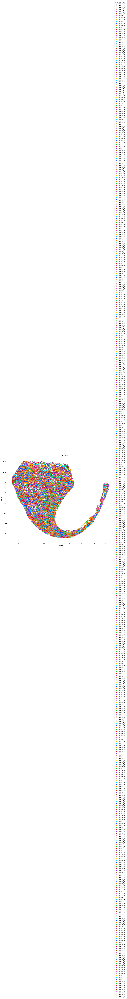

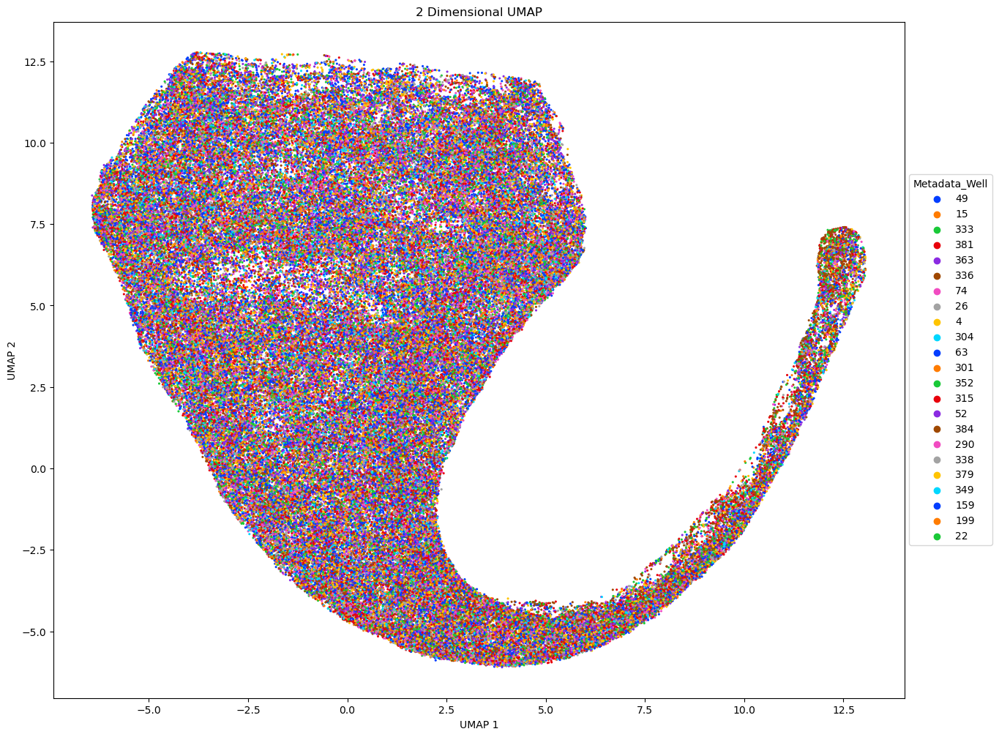

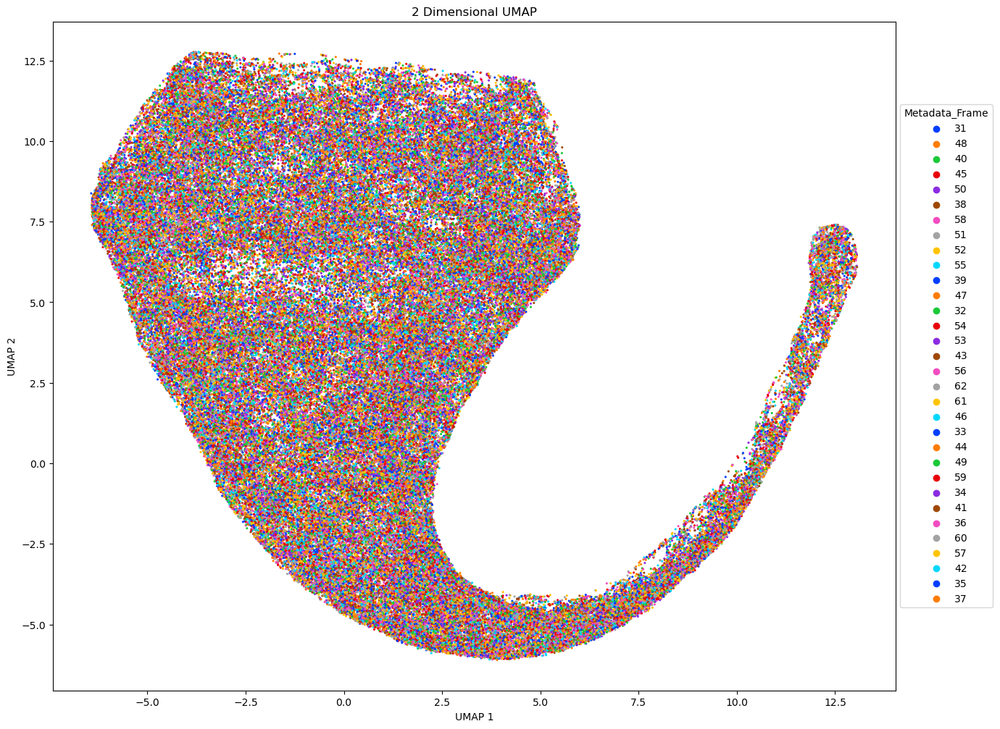

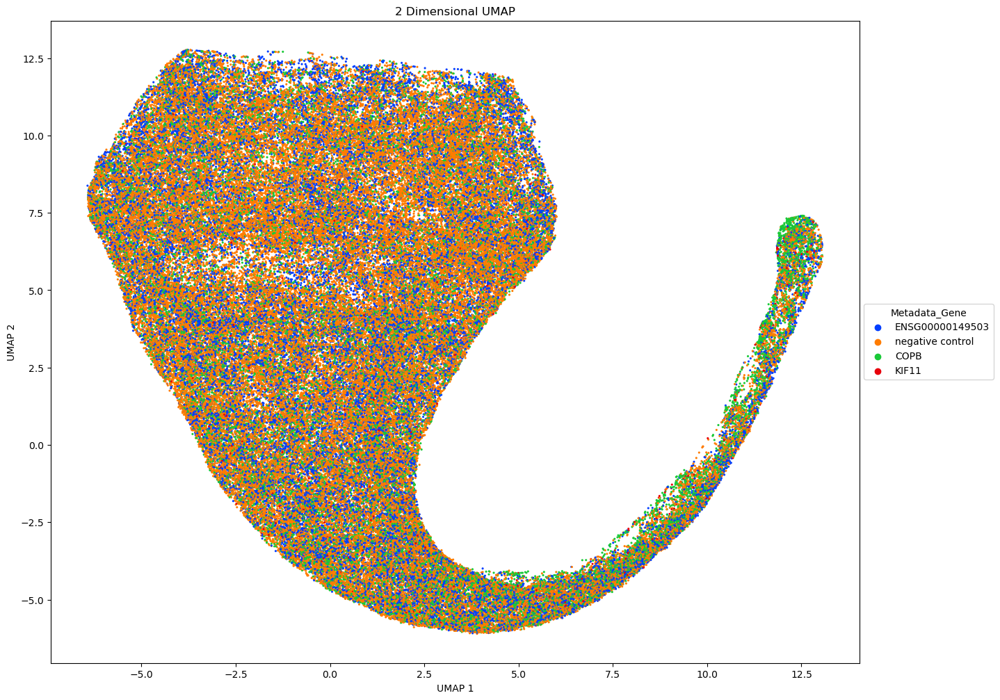

In [3]:
metadata_dataframe, feature_data = split_data(control_data, "CP")
x_data, y_data = get_2D_umap_embeddings(feature_data)

metadata_fields = ["Metadata_Plate", "Metadata_Well", "Metadata_Frame", "Metadata_Gene"]

for metadata_field in metadata_fields:
    metadata = metadata_dataframe[metadata_field]
    show_2D_umap_from_embeddings(x_data, y_data, metadata)

### Create 2D umaps colored by metadata (with DP features)

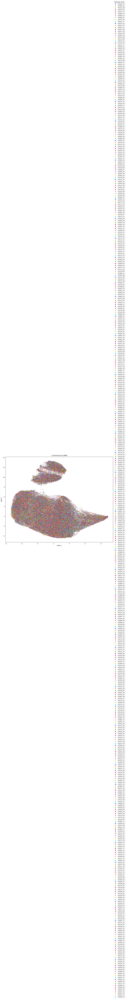

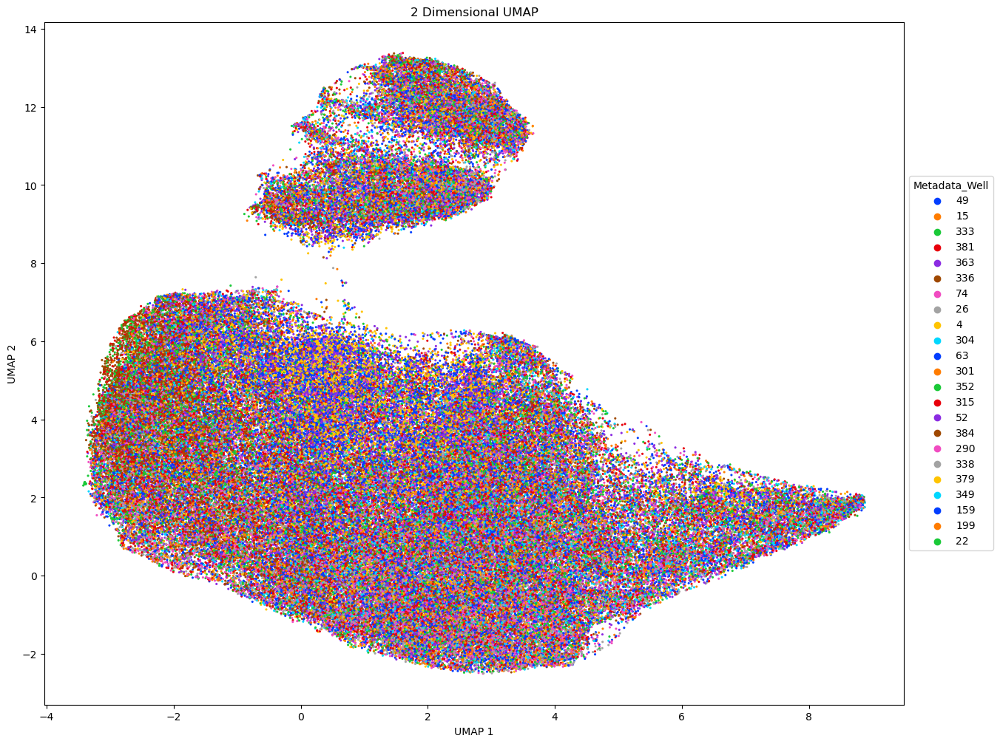

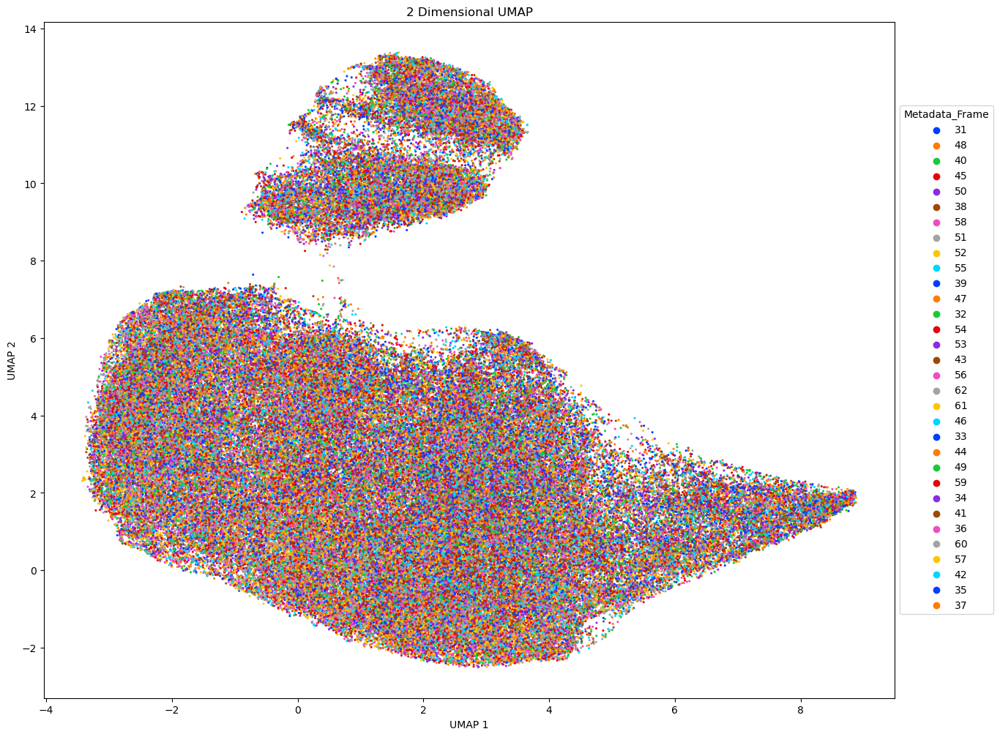

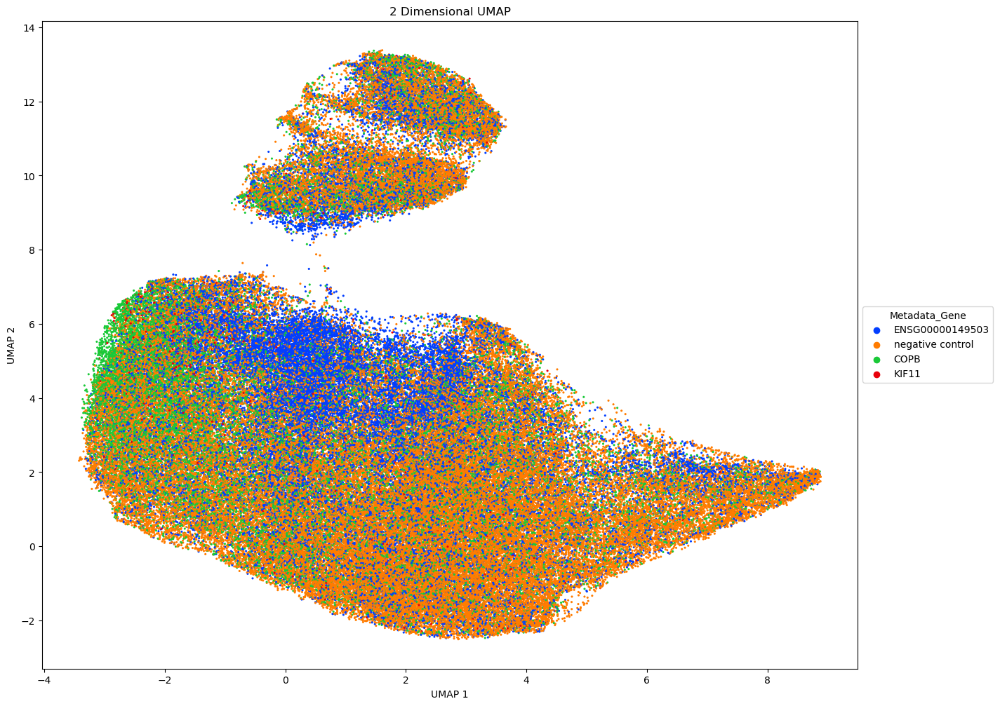

In [4]:
metadata_dataframe, feature_data = split_data(control_data, "DP")
x_data, y_data = get_2D_umap_embeddings(feature_data)

metadata_fields = ["Metadata_Plate", "Metadata_Well", "Metadata_Frame", "Metadata_Gene"]

for metadata_field in metadata_fields:
    metadata = metadata_dataframe[metadata_field]
    show_2D_umap_from_embeddings(x_data, y_data, metadata)

### Create 2D umaps colored by metadata (with CP and DP features)

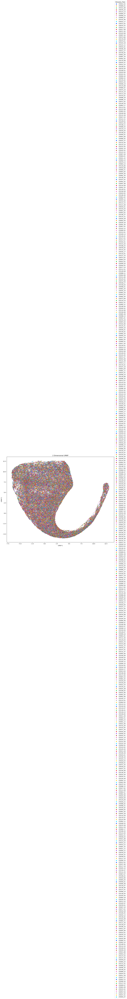

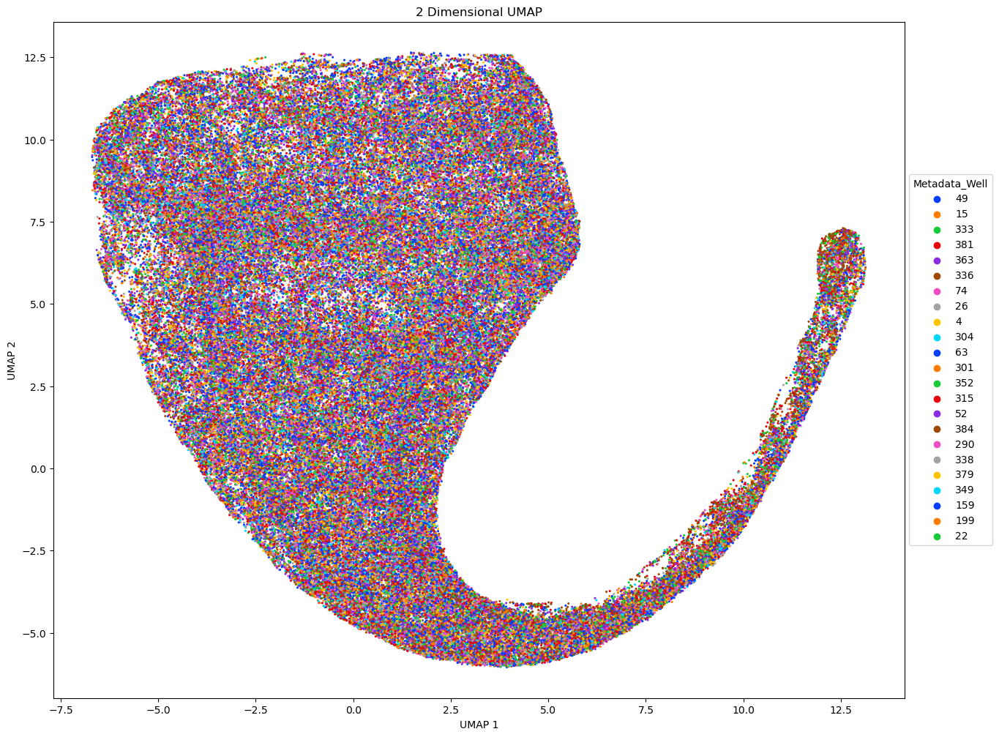

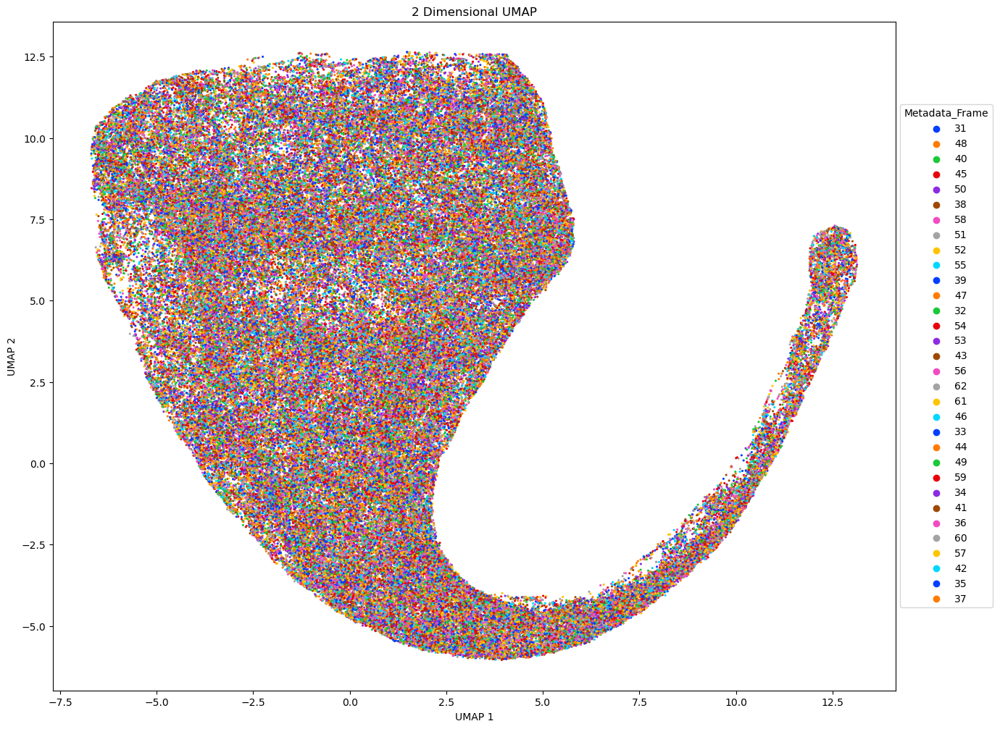

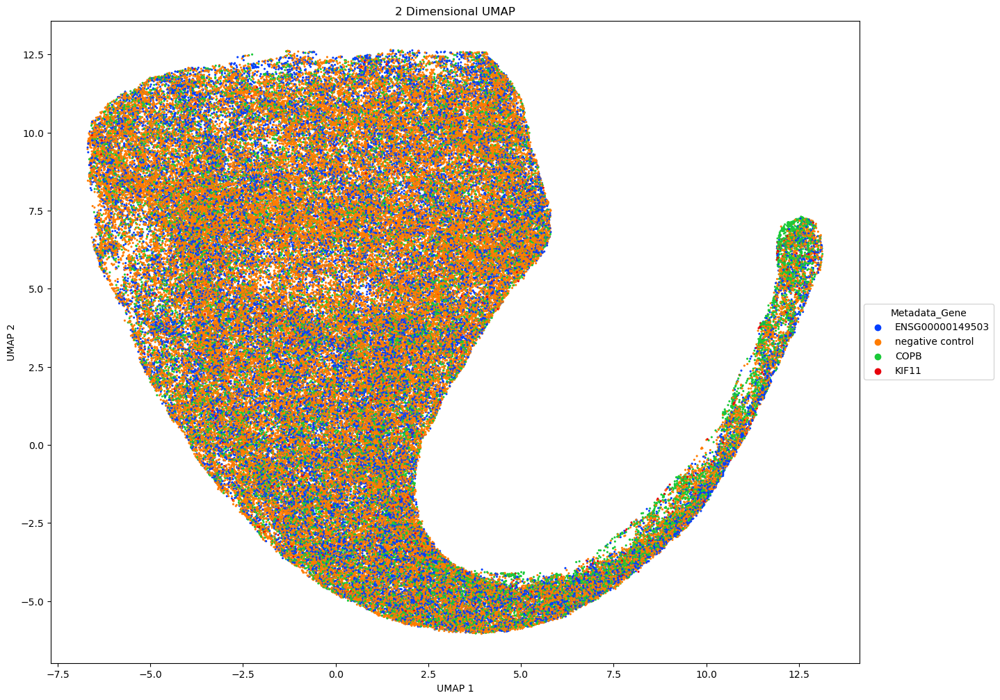

In [5]:
metadata_dataframe, feature_data = split_data(control_data)
x_data, y_data = get_2D_umap_embeddings(feature_data)

metadata_fields = ["Metadata_Plate", "Metadata_Well", "Metadata_Frame", "Metadata_Gene"]

for metadata_field in metadata_fields:
    metadata = metadata_dataframe[metadata_field]
    show_2D_umap_from_embeddings(x_data, y_data, metadata)